# Reduce Science images : Example of HD158485


- Creation : Friday 2016 June 10th
- Author Sylvie Dagoret-Campagne (SDC adapted for LSST from Matt Craig's example notebook)
- affiliation : LAL/IN2P3/CNRS


Do the ISR for sciencie images. In this ipython notebook work with HD158485



In [22]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits

import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [23]:
from scipy import stats  
import os
from datetime import datetime, timedelta

In [24]:
import libMonocamBaseImages

In [25]:
now=datetime.utcnow()  # choose UTC time
datestr=str(now)
print 'standard date format for the analysis :',datestr
#  want the following format '2016-05-10T11:55:27.267'
date_of_analysis=now.strftime('%Y-%m-%dT%H:%M:%S')
print 'fits date format for the analysis : ',date_of_analysis

standard date format for the analysis : 2016-06-10 12:35:16.701984
fits date format for the analysis :  2016-06-10T12:35:16


In [26]:
NB_OF_CHAN_AMPL=16    # 16 images in each of the fits file

## 1) Get the master bias  

In [27]:
path='.'
basefilename='masterbias_ostrim_1.fits' # check master bias
filename=os.path.join(path,basefilename)
vmin=-2
vmax=2
outputfigfilename='MasterBiasUsedinISR_img.pdf'

In [28]:
allbias = []
for chan in range(1,NB_OF_CHAN_AMPL+1,1):
    ccd_chan = ccdproc.CCDData.read(filename, hdu=chan,unit="adu") 
    allbias.append(ccd_chan)

In [29]:
mbheader=allbias[0].header
mbheader['DATE-ANA']=date_of_analysis

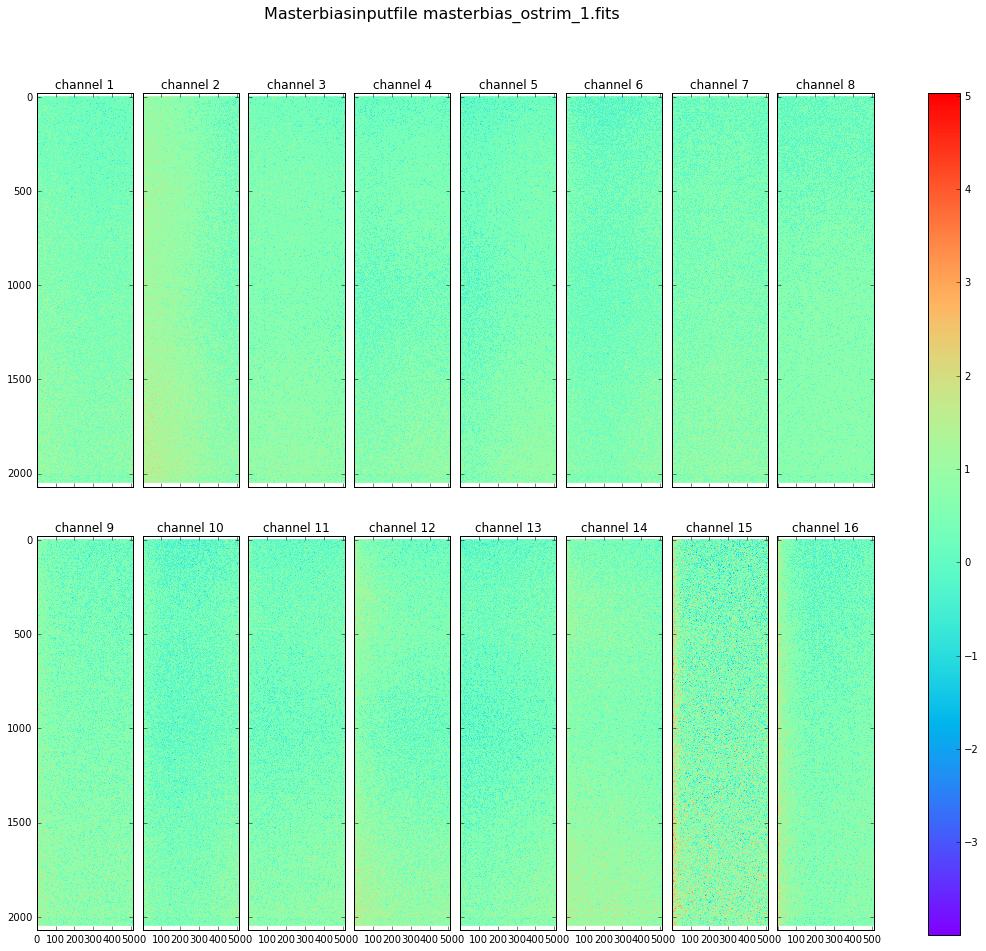

In [30]:
libMonocamBaseImages.ShowImagesSet(allbias,'Masterbias',basefilename,outputfigfilename,nbsig=10)

In [31]:
#libMonocamBaseImages.ShowHistoSet(allbias,'Masterbias distributions',basefilename,'masterbiases_hist.pdf',nbsig=10)

## 2) Get the scaled darks

In [32]:
path='.'
basefilename='masterdarkscaled_ostrim_1.fits' # check master dark
filename=os.path.join(path,basefilename)
outputfigfilename='MasterDarkUsedinISR_img.pdf'

In [33]:
alldarks = []
for chan in range(1,NB_OF_CHAN_AMPL+1,1):
    ccd_chan = ccdproc.CCDData.read(filename, hdu=chan,unit="adu") 
    alldarks.append(ccd_chan)

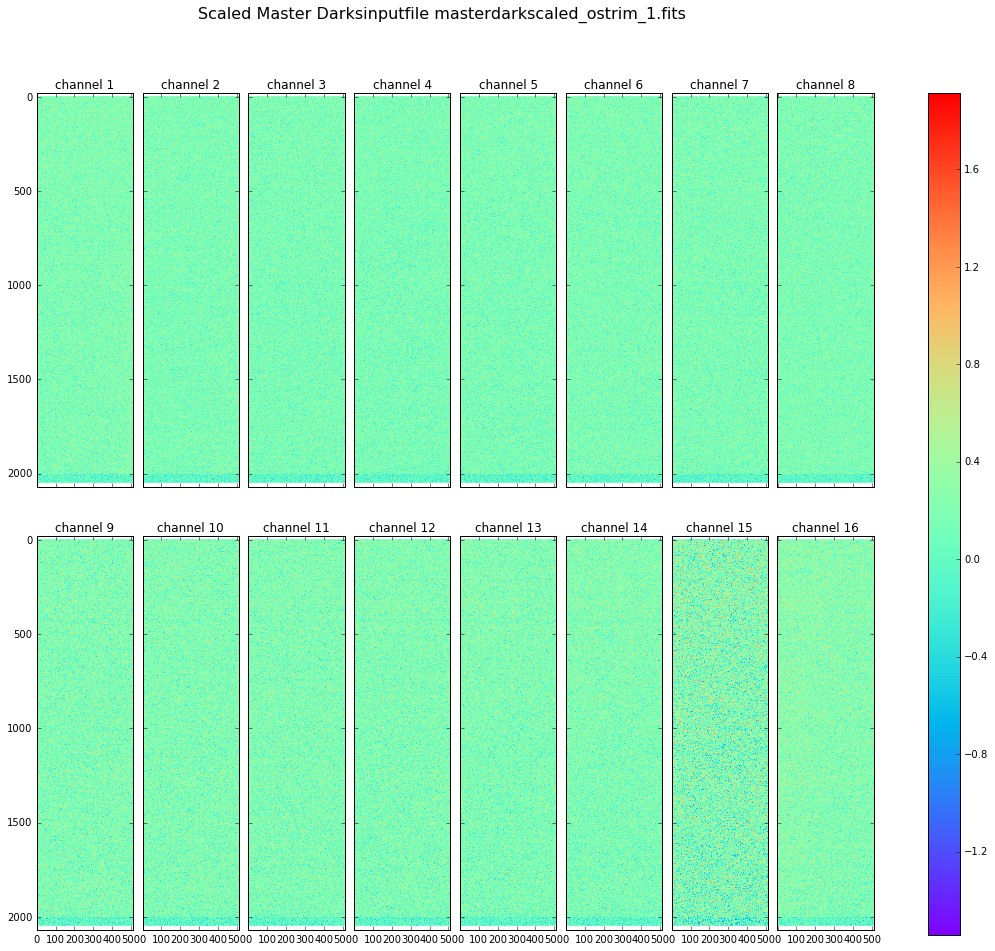

In [34]:
libMonocamBaseImages.ShowImagesSet(alldarks,'Scaled Master Darks',basefilename,outputfigfilename,nbsig=10)

In [35]:
#libMonocamBaseImages.ShowHistoSet(alldarks,'Masterdarks distributions',basefilename,'masterdarks_hist.pdf',nbsig=10)

## 3)  Get the Master flats

In [36]:
path='.'
basefilename='masterflat_1-40.fits' # check master bias
filename=os.path.join(path,basefilename)
vmin=-2
vmax=2
outputfigfilename='MasterFlatUsedinISR_img.pdf'

In [37]:
allflats = []
for chan in range(1,NB_OF_CHAN_AMPL+1,1):
    ccd_chan = ccdproc.CCDData.read(filename, hdu=chan,unit="adu") 
    allflats.append(ccd_chan)

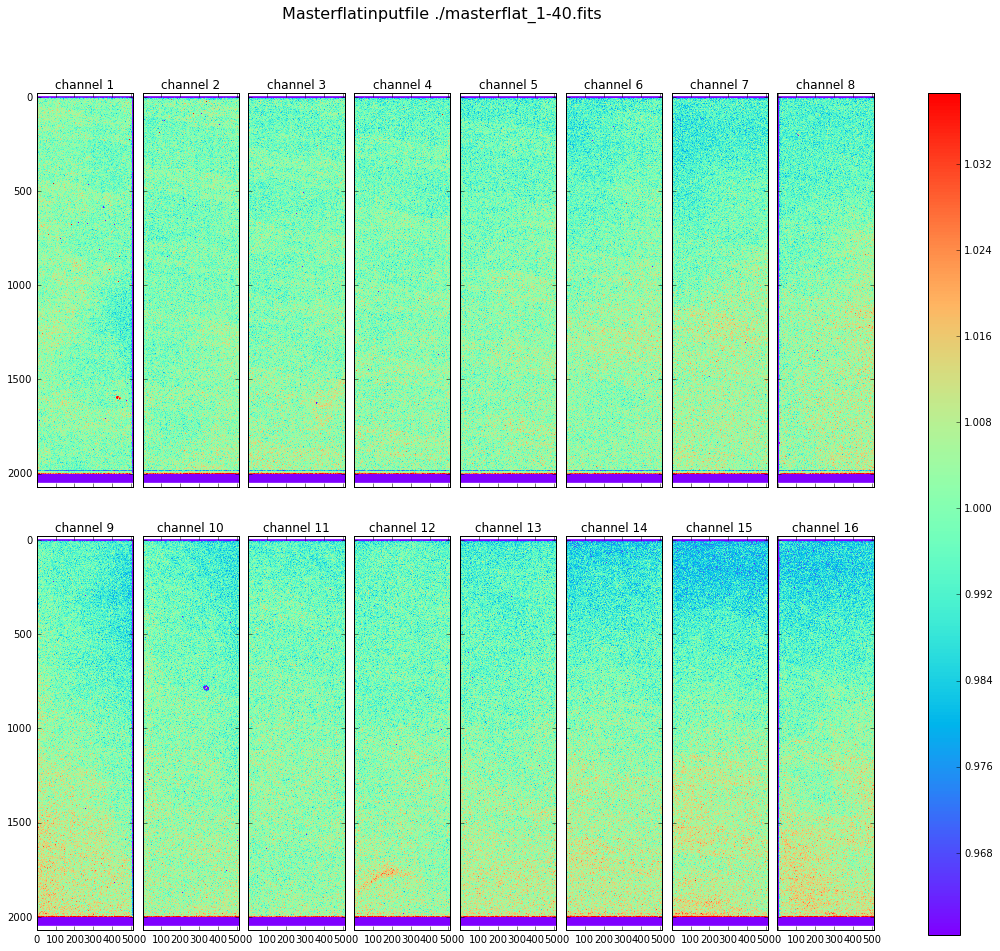

In [38]:
libMonocamBaseImages.ShowImagesSet(allflats,'Masterflat',filename,outputfigfilename,nbsig=3)


In [39]:
def oscan_and_trim(image_list):
    """
    Remove overscan and trim a list of images. The original list is replaced by a list of images
    with the changes applied.
    """
    for idx, img in enumerate(image_list):
        oscan = ccdproc.subtract_overscan(img,overscan=img[:,521:544], add_keyword={'oscan_sub': True, 'calstat': 'O'}, model=models.Polynomial1D(1))
        image_list[idx] = ccdproc.trim_image(oscan[:,10:521], add_keyword={'trimmed': True, 'calstat': 'OT'})

## Science Image

In [50]:
path='/Users/dagoret-campagnesylvie/iraf/MonoCamMay2016/20160509'
root_sciimagefilename='HD158485_grat_'
sciimage_startnum=1
sciimage_stopnum=25
outputfigfilename=root_sciimagefilename+'.pdf'

In [46]:
rawsciimages_list=libMonocamBaseImages.BuildFilelist(path,root_sciimagefilename,start=sciimage_startnum,stop=sciimage_stopnum)

In [47]:
NB_OF_SCIIMAGES=len(rawsciimages_list)

In [60]:
allchannelallsciimages = []  # list of 16 lists of images series 
exposures_list = []        # sequential list of the exposures of the sky flats 
header_list = []           # list of headers

# get the primary block headers:
for image_file in rawsciimages_list: 
    hdu_list = fits.open(image_file)
    header=hdu_list[0].header
    number_of_channels=header['CHAN']
    exposure=header['EXPOSURE']
    exposures_list.append(exposure)
    header_list.append(header)

# get the CCD images:
for chan in range(1,NB_OF_CHAN_AMPL+1,1): # loop on channel
    fileindex=0
    allsciimages = []  # container of flats for a given channel
    for image_file in rawsciimages_list:       
        ccd_chan = ccdproc.CCDData.read(image_file, hdu=chan,unit="adu")
        allsciimages.append(ccd_chan)  # image extension
        fileindex=fileindex+1
    allchannelallsciimages.append(allsciimages)

In [49]:
exposures_list

[1.0,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5,
 1.5]

# Calibrate Science images

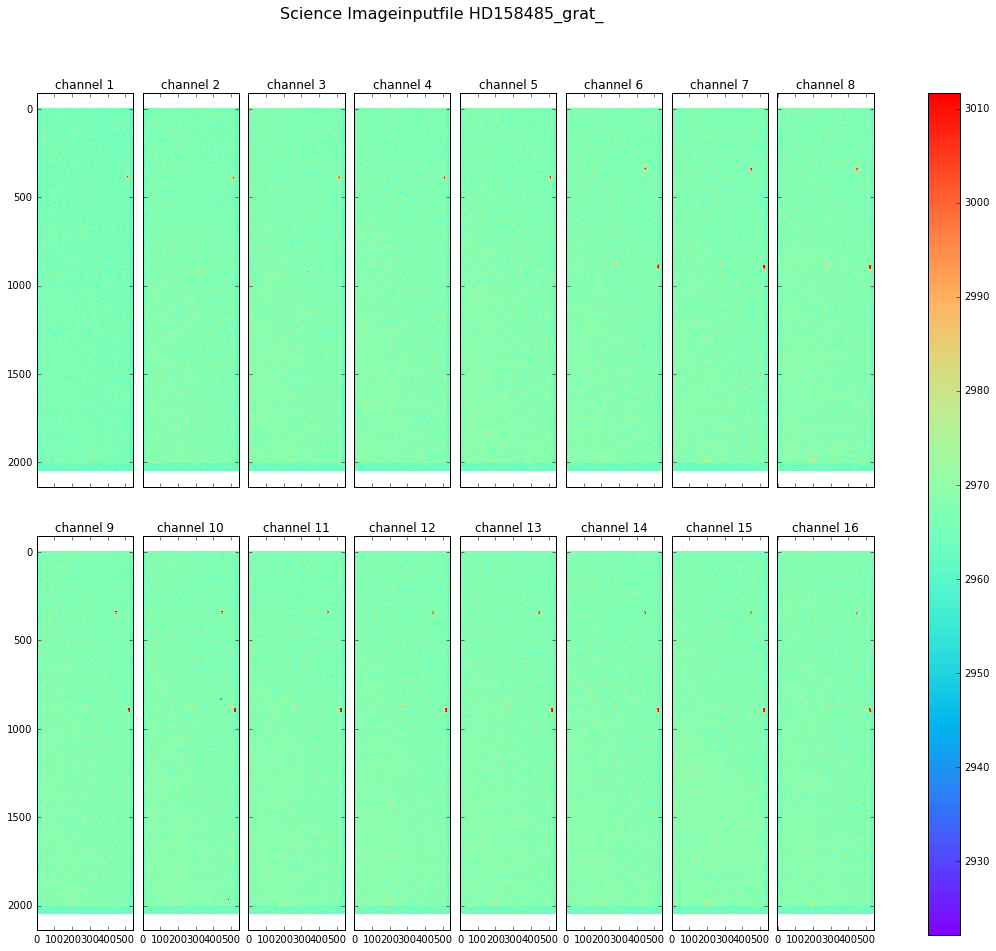

In [52]:
libMonocamBaseImages.ShowImagesSet(allchannelallsciimages[0],'Science Image',root_sciimagefilename,outputfigfilename,nbsig=3.)

In [54]:
index=0

# Process image by image

In [67]:
allchannelscorrectedimages = [] 
for im in range(NB_OF_SCIIMAGES): # loop over fits file images
    ccd_subset_of_16corrimages=[] # collector of corrected 16 sub-images per image fits-file
    for chan in range(NB_OF_CHAN_AMPL): # loop on channels
        correctedimage=ccdproc.ccd_process(allchannelallsciimages[chan][im], # apply all corrections
                                           oscan='[522:544,:]',              # substract osverscan region
                                           trim='[11:521,:]',                # does the trimming
                                           error=False,      
                                           master_bias=allbias[chan],        # bias subtraction
                                           dark_frame=alldarks[chan],        # normalised dark  
                                           dark_exposure=1*u.second,         # duration of the dark exposure
                                           data_exposure=exposures_list[im]*u.second, # duration of data exposure
                                           dark_scale=True,                  # normalize the dark to data exposure
                                           master_flat=allflats[chan],       # master flat
                                           add_keyword={'oscan_sub': True,'calstat': 'OTBDF'}
                                          )
        ccd_subset_of_16corrimages.append(correctedimage)
    allchannelscorrectedimages.append(ccd_subset_of_16corrimages)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


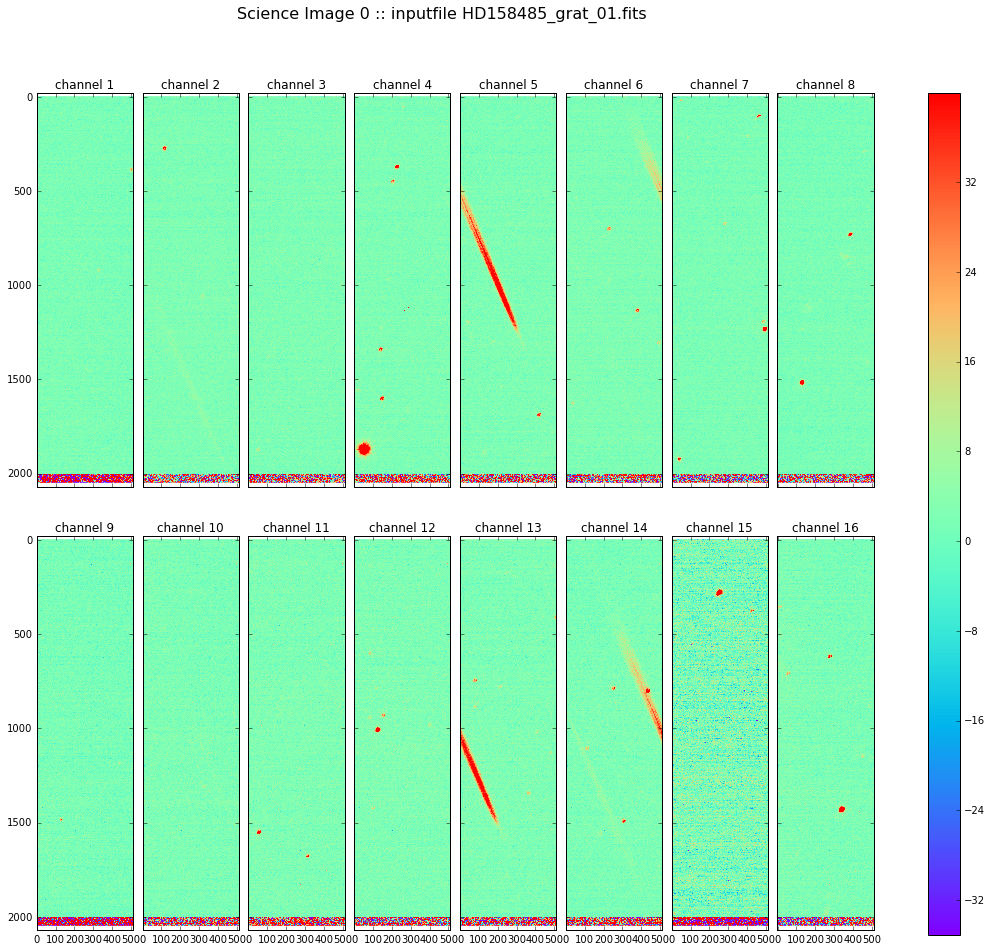

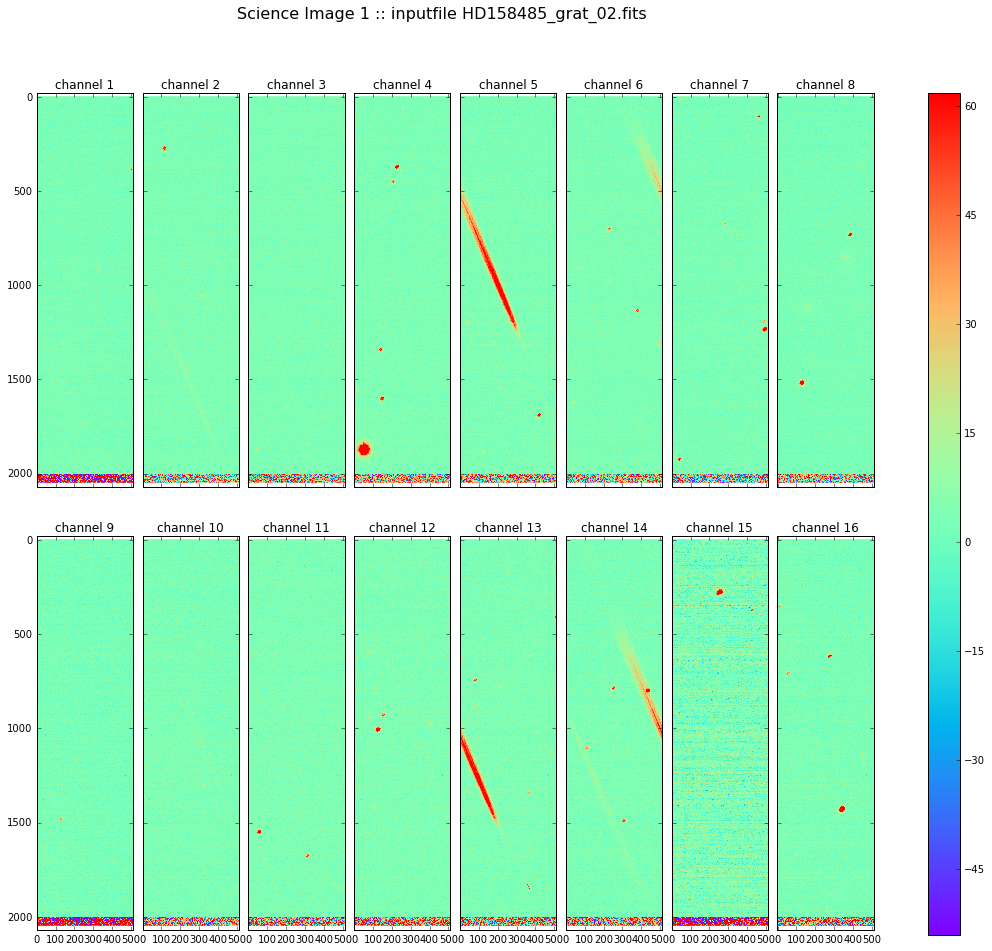

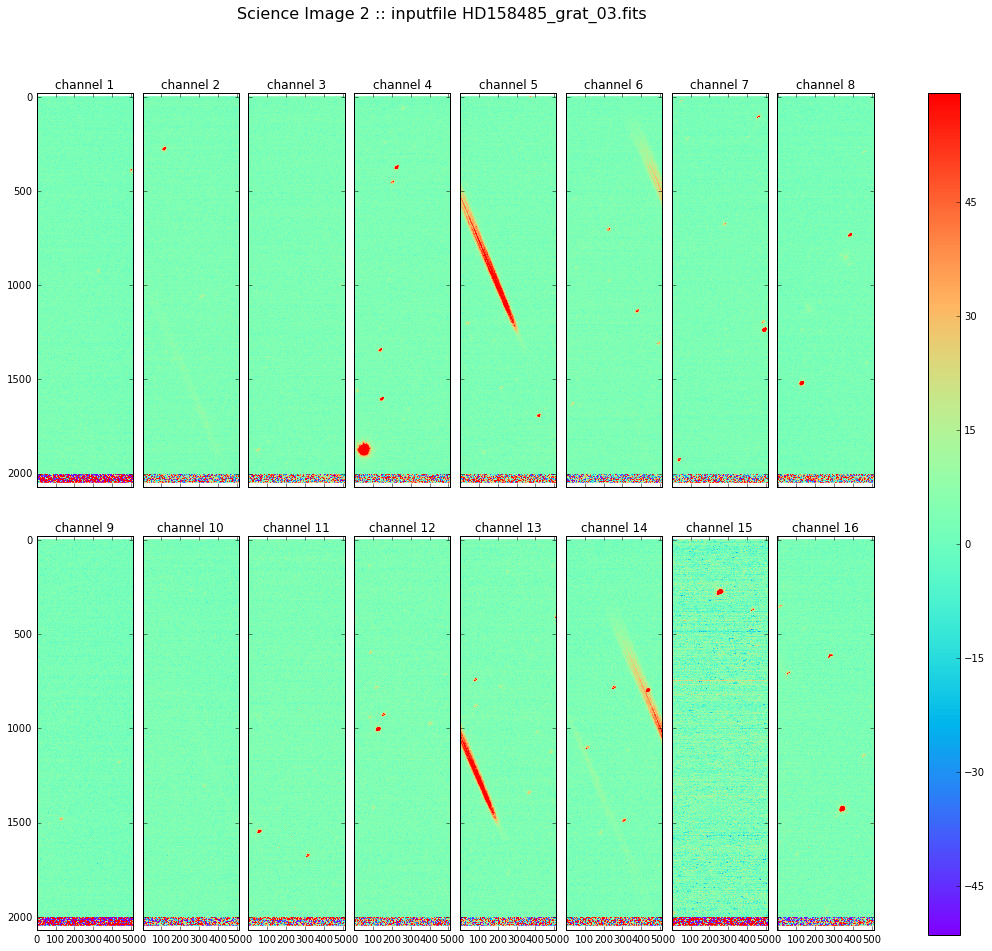

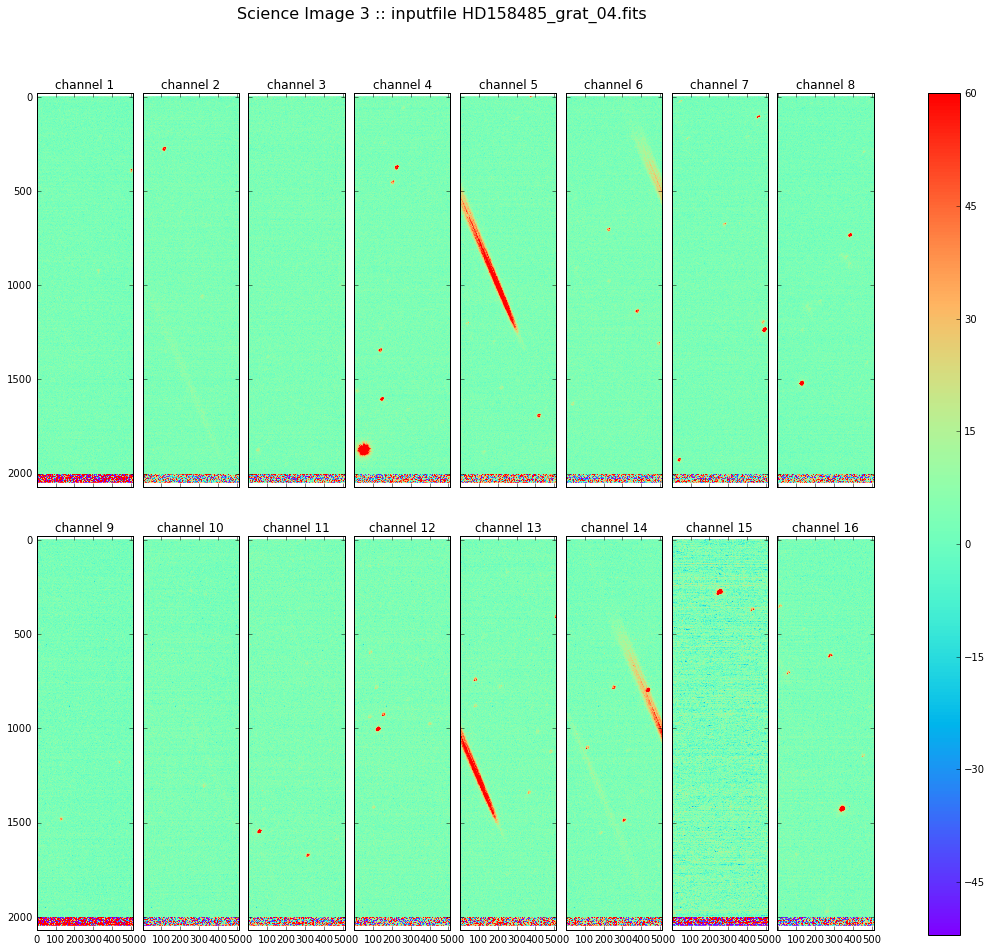

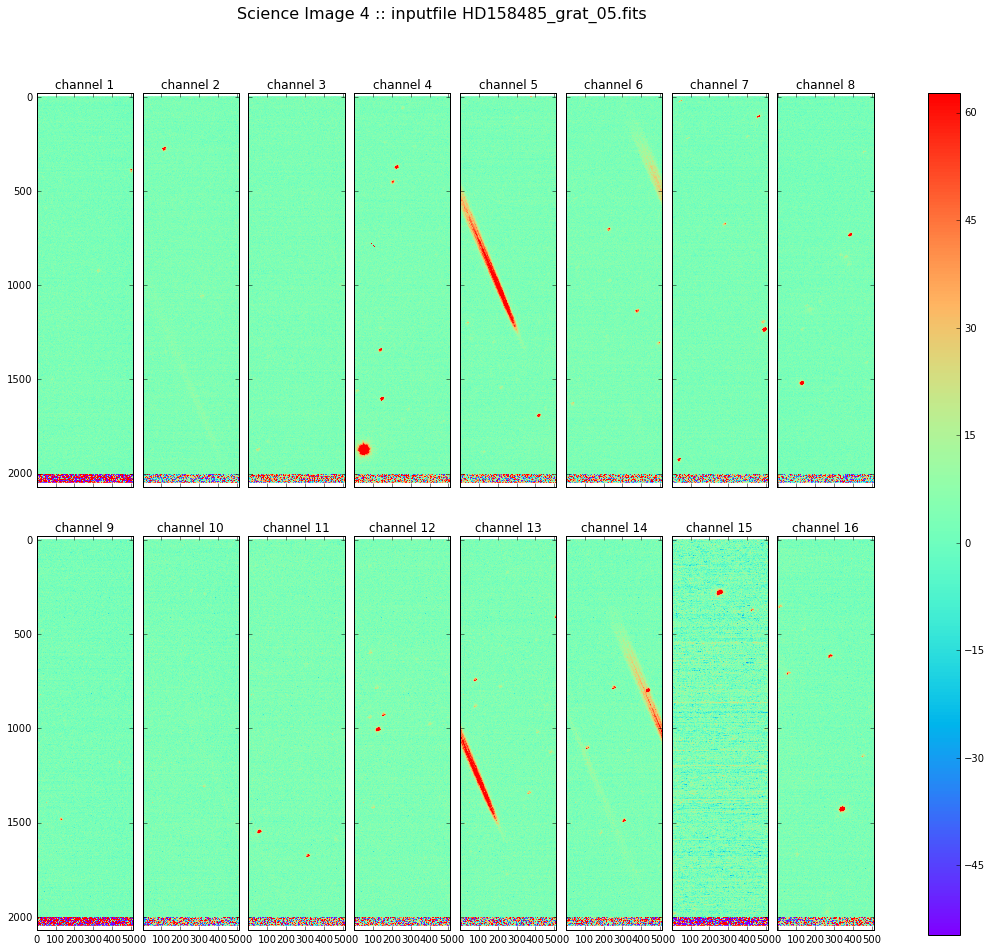

...

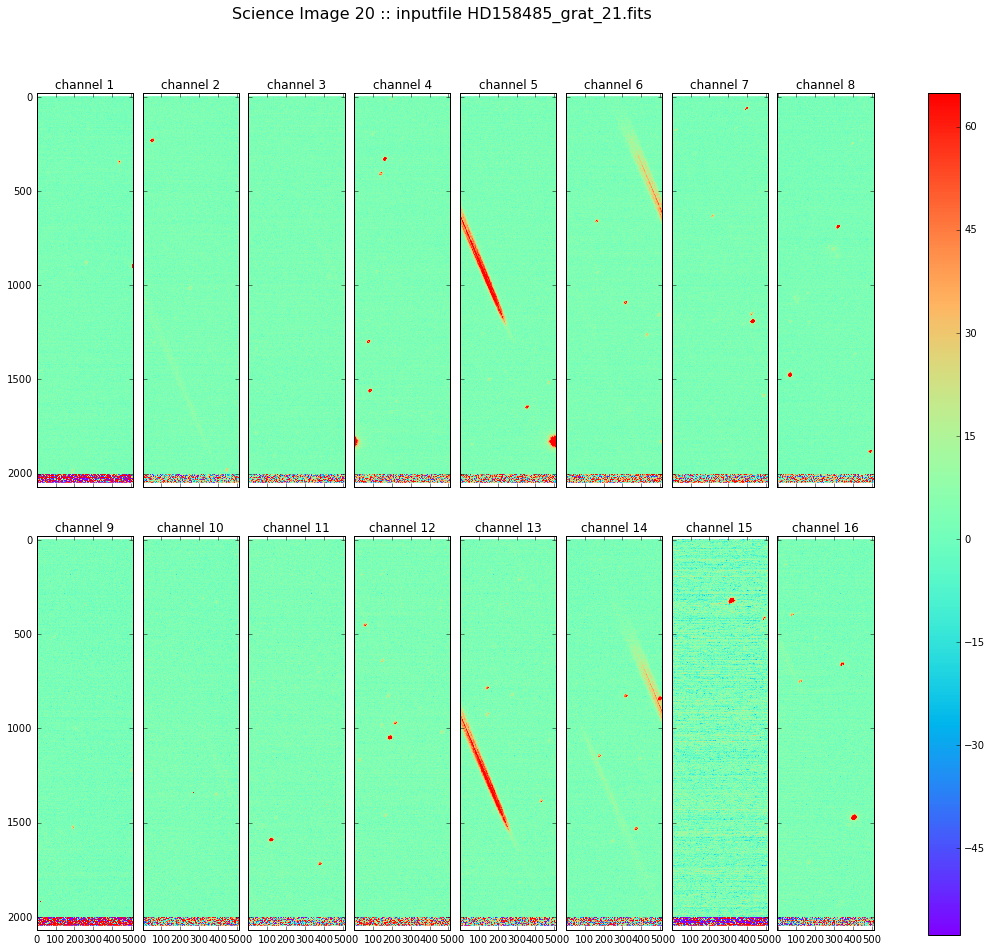

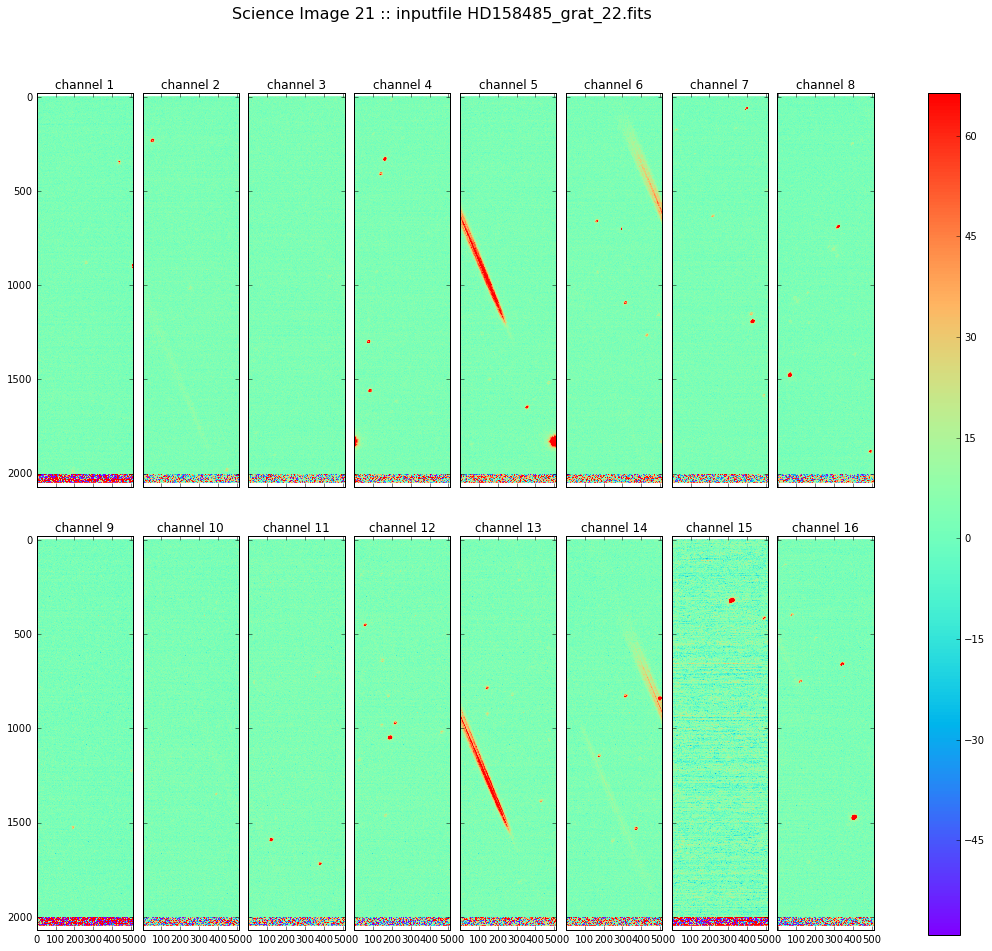

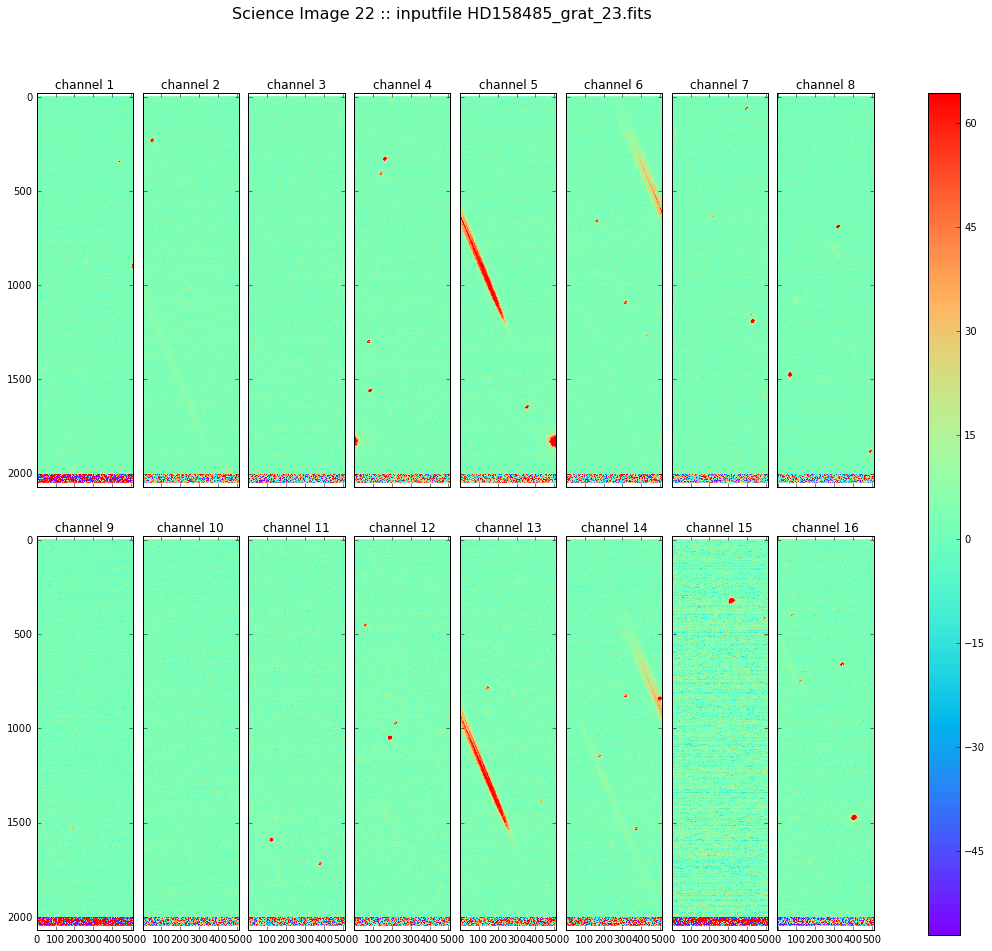

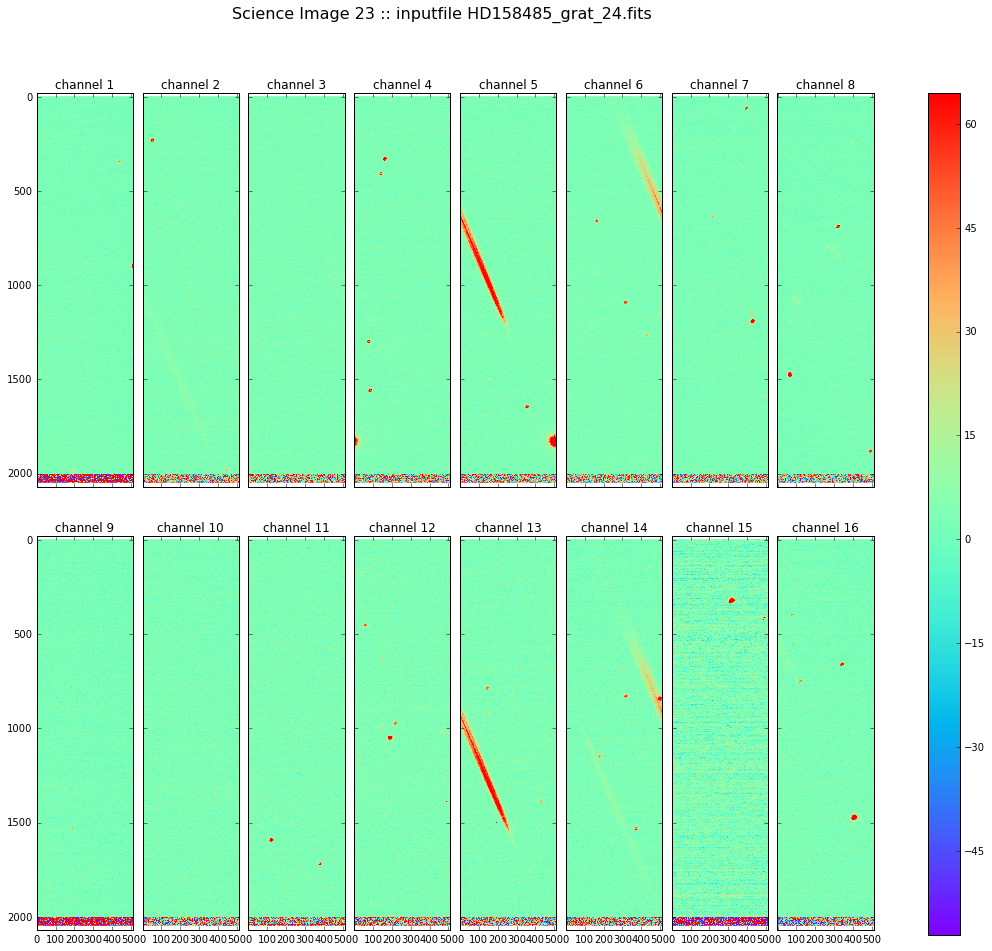

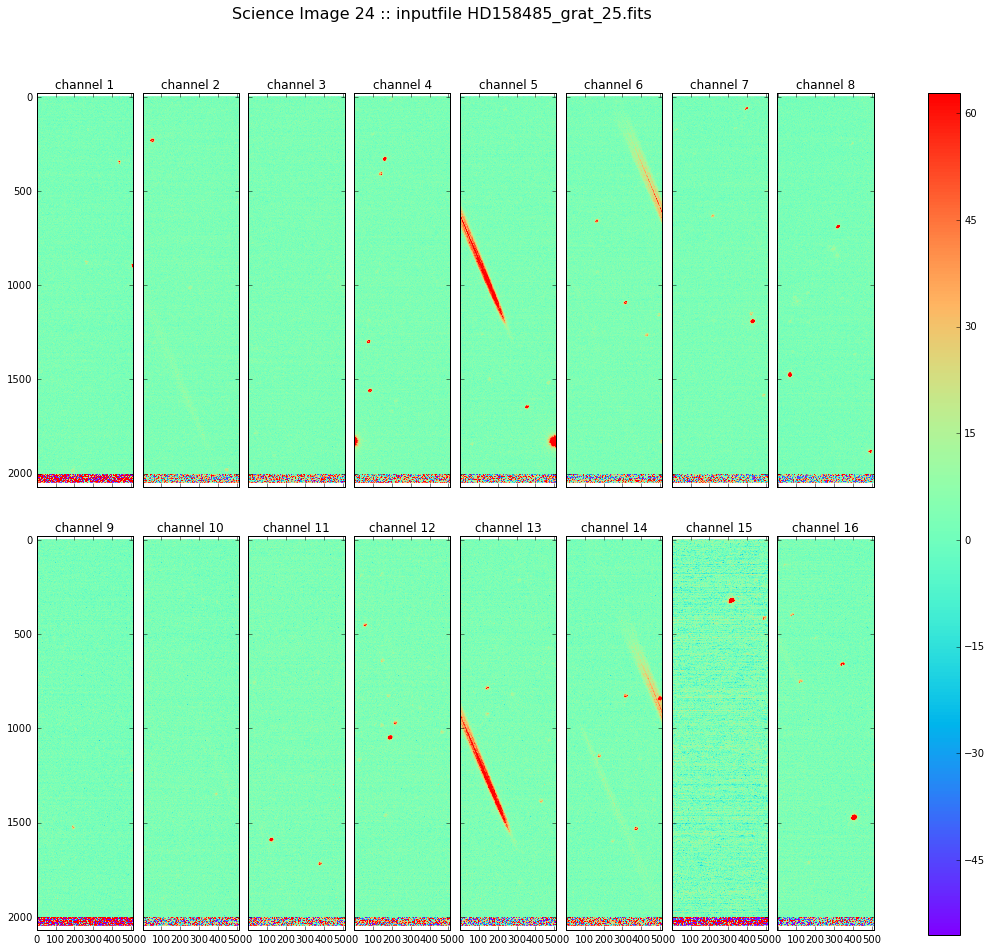

In [75]:
for im in range(NB_OF_SCIIMAGES): # loop over fits file images
    image_title='Science Image '+str(im)+' :: '
    root_sciimagefilename=os.path.basename(rawsciimages_list[im])
    outputfigfilename=root_sciimagefilename.split('.')[0]+'.pdf'    
    #print image_title,root_sciimagefilename , outputfigfilename
    libMonocamBaseImages.ShowImagesSet(allchannelscorrectedimages[im],image_title,root_sciimagefilename,outputfigfilename,nbsig=3.)

## Combine the Science Images

In [ ]:
for im in range(NB_OF_SCIIMAGES): # loop over fits file images
    image_title='Science Image '+str(im)+' :: '
    root_sciimagefilename=os.path.basename(rawsciimages_list[im])
    outputfigfilename=root_sciimagefilename.split('.')[0]+'.pdf'    
    #print image_title,root_sciimagefilename , outputfigfilename
    libMonocamBaseImages.ShowImagesSet(allchannelscorrectedimages[im],image_title,root_sciimagefilename,outputfigfilename,nbsig=3.)